In [1]:
# installing packages like
# !pip install pandas

In [2]:
# importing packages
import pandas as pd
import numpy as np
import warnings, gc
warnings.filterwarnings("ignore")

In [3]:
# Dataset: "https://www.kaggle.com/competitions/jpx-tokyo-stock-exchange-prediction/"
stock_prices = pd.read_csv("stock_prices.csv", parse_dates = ['Date'])
stock_lists = pd.read_csv("stock_list.csv")

print("The training data begins on {} and ends on {}.\n".format(stock_prices.Date.min(), stock_prices.Date.max()))

The training data begins on 2017-01-04 00:00:00 and ends on 2021-12-03 00:00:00.



In [4]:
stock_prices.head()

,RowId,Date,SecuritiesCode,Open,High,Low,Close,Volume,AdjustmentFactor,ExpectedDividend,SupervisionFlag,Target
0,20170104_1301,2017-01-04,1301,2734.0,2755.0,2730.0,2742.0,31400,1.0,NaN,False,0.000730
1,20170104_1332,2017-01-04,1332,568.0,576.0,563.0,571.0,2798500,1.0,NaN,False,0.012324
2,20170104_1333,2017-01-04,1333,3150.0,3210.0,3140.0,3210.0,270800,1.0,NaN,False,0.006154
3,20170104_1376,2017-01-04,1376,1510.0,1550.0,1510.0,1550.0,11300,1.0,NaN,False,0.011053
4,20170104_1377,2017-01-04,1377,3270.0,3350.0,3270.0,3330.0,150800,1.0,NaN,False,0.003026


In [5]:
display(stock_prices.describe().style.format('{:,.2f}'))

,Date,SecuritiesCode,Open,High,Low,Close,Volume,AdjustmentFactor,ExpectedDividend,Target
count,"2,332,531.00","2,332,531.00","2,324,923.00","2,324,923.00","2,324,923.00","2,324,923.00","2,332,531.00","2,332,531.00","18,865.00","2,332,293.00"
mean,",.2f","5,894.84","2,594.51","2,626.54","2,561.23","2,594.02","691,936.56",1.00,22.02,0.00
min,",.2f","1,301.00",14.00,15.00,13.00,14.00,0.00,0.10,0.00,-0.58
25%,",.2f","3,891.00","1,022.00","1,035.00","1,009.00","1,022.00","30,300.00",1.00,5.00,-0.01
50%,",.2f","6,238.00","1,812.00","1,834.00","1,790.00","1,811.00","107,100.00",1.00,15.00,0.00
75%,",.2f","7,965.00","3,030.00","3,070.00","2,995.00","3,030.00","402,100.00",1.00,30.00,0.01
max,",.2f","9,997.00","109,950.00","110,500.00","107,200.00","109,550.00","643,654,000.00",20.00,"1,070.00",1.12
std,nan,"2,404.16","3,577.19","3,619.36","3,533.49","3,576.54","3,911,255.94",0.07,29.88,0.02


In [6]:
target_mean_per_stock = stock_prices.groupby(['SecuritiesCode'])['Target'].mean()
target_mean = target_mean_per_stock.mean()
#target_mean_per_stock
target_mean

0.0004714963317502812

### Data Visualization

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

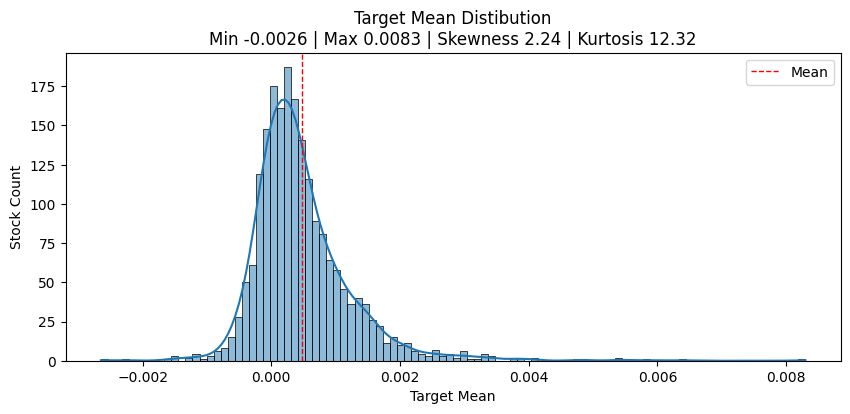

In [8]:
fig, ax = plt.subplots(figsize = (10, 4))
sns.histplot(data = target_mean_per_stock.values, bins = 100, kde = True, ax = ax)
ax.axvline(x = target_mean, color = 'red', linestyle = 'dashed', linewidth = 1, label = 'Mean')
ax.set_title("Target Mean Distibution\n"
             f"Min {round(target_mean_per_stock.min(), 4)} | "
             f"Max {round(target_mean_per_stock.max(), 4)} | "
             f"Skewness {round(target_mean_per_stock.skew(), 2)} | "
             f"Kurtosis {round(target_mean_per_stock.kurtosis(), 2)}")
ax.set_xlabel("Target Mean")
ax.set_ylabel("Stock Count")
ax.legend()
plt.show()

In [9]:
target_stdev_per_stock = stock_prices.groupby(['SecuritiesCode'])['Target'].std()
target_stdev_mean = target_stdev_per_stock.mean()
#target_stdev_per_stock
target_stdev_mean

0.022768322656291782

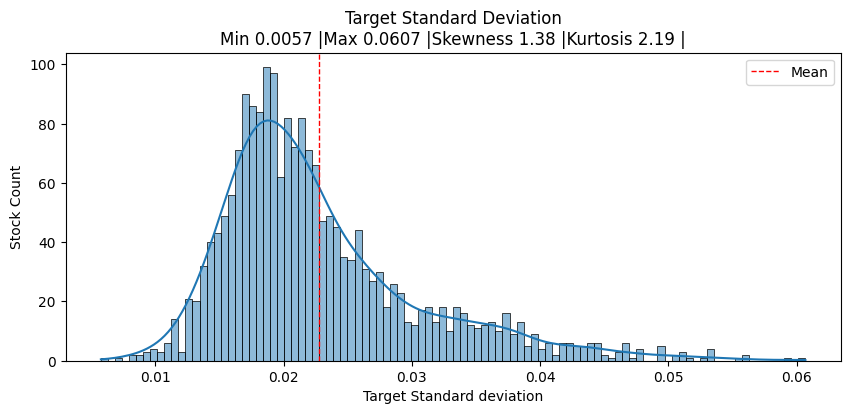

In [10]:
fig, ax = plt.subplots(figsize = (10, 4))
sns.histplot(data = target_stdev_per_stock.values, bins = 100, kde = True, ax = ax)
ax.axvline(x = target_stdev_mean, color = 'red', linestyle = 'dashed', linewidth = 1, label = 'Mean')
ax.set_title("Target Standard Deviation\n"
            f"Min {round(target_stdev_per_stock.min(), 4)} |"
            f"Max {round(target_stdev_per_stock.max(), 4)} |"
            f"Skewness {round(target_stdev_per_stock.skew(), 2)} |"
            f"Kurtosis {round(target_stdev_per_stock.kurtosis(), 2)} |")
ax.set_xlabel("Target Standard deviation")
ax.set_ylabel("Stock Count")
ax.legend()
plt.show()

In [11]:
stock_lists.head()

,SecuritiesCode,EffectiveDate,Name,Section/Products,NewMarketSegment,33SectorCode,33SectorName,17SectorCode,17SectorName,NewIndexSeriesSizeCode,NewIndexSeriesSize,TradeDate,Close,IssuedShares,MarketCapitalization,Universe0
0,1301,20211230,"KYOKUYO CO.,LTD.",First Section (Domestic),Prime Market,50,"Fishery, Agriculture and Forestry",1,FOODS,7,TOPIX Small 2,20211230.0,3080.0,1.092828e+07,3.365911e+10,True
1,1305,20211230,Daiwa ETF-TOPIX,ETFs/ ETNs,NaN,-,-,-,-,-,-,20211230.0,2097.0,3.634636e+09,7.621831e+12,False
2,1306,20211230,NEXT FUNDS TOPIX Exchange Traded Fund,ETFs/ ETNs,NaN,-,-,-,-,-,-,20211230.0,2073.5,7.917718e+09,1.641739e+13,False
3,1308,20211230,Nikko Exchange Traded Index Fund TOPIX,ETFs/ ETNs,NaN,-,-,-,-,-,-,20211230.0,2053.0,3.736943e+09,7.671945e+12,False
4,1309,20211230,NEXT FUNDS ChinaAMC SSE50 Index Exchange Trade...,ETFs/ ETNs,NaN,-,-,-,-,-,-,20211230.0,44280.0,7.263200e+04,3.216145e+09,False


In [12]:
display(stock_lists.describe().style)

,SecuritiesCode,EffectiveDate,TradeDate,Close,IssuedShares,MarketCapitalization
count,4417.000000,4417.000000,4121.000000,4121.000000,4121.000000,4121.000000
mean,5547.191306,20197579.726738,20211229.954137,6376.734700,89922667.041686,218440012227.214966
std,2499.027227,51968.418358,0.510647,38091.520255,487167544.354170,1309480999287.264404
min,1301.000000,20000101.000000,20211216.000000,1.800000,2242.000000,38786600.000000
25%,3423.000000,20211230.000000,20211230.000000,728.000000,5944100.000000,5912841000.000000
50%,5711.000000,20211230.000000,20211230.000000,1397.000000,14950074.000000,18225000000.000000
75%,7616.000000,20211230.000000,20211230.000000,2595.000000,42678998.000000,68114880000.000000
max,25935.000000,20220225.000000,20211230.000000,711000.000000,16314987460.000000,52192239810720.000000


In [13]:
def process_stocks(stock_lists):
    stock_lists['Name'] = [i.rstrip().lower().capitalize() for i in stock_lists['Name']]
    stock_lists['SectorName'] = [i.rstrip().lower().capitalize() for i in stock_lists['17SectorName']]
    return stock_lists

def merge_price_stock(stock_prices, stock_lists):
    train_df = stock_prices.merge(stock_lists[['SecuritiesCode', 'Name', 'SectorName']], on='SecuritiesCode', how='left')
    train_df['Year'] = train_df['Date'].dt.year
    return train_df

def yearly_avg_returns(train_df):
    years = {year: pd.DataFrame() for year in train_df.Year.unique()[::-1]}
    for key in years.keys():
        df = train_df[train_df.Year == key]        
        years[key] = df.groupby('SectorName')['Target'].mean().mul(100).rename("Avg_return_{}".format(key))    
    df = pd.concat((years[i].to_frame() for i in years.keys()), axis = 1)
    df = df.sort_values(by = "Avg_return_2021")
    return df
    
stock_lists = process_stocks(stock_lists)
train_df = merge_price_stock(stock_prices, stock_lists)
print(train_df.columns)

Index(['RowId', 'Date', 'SecuritiesCode', 'Open', 'High', 'Low', 'Close',
       'Volume', 'AdjustmentFactor', 'ExpectedDividend', 'SupervisionFlag',
       'Target', 'Name', 'SectorName', 'Year'],
      dtype='object')


In [14]:
yearly_avg_returns = yearly_avg_returns(train_df)
yearly_avg_returns.head()

,Avg_return_2021,Avg_return_2020,Avg_return_2019,Avg_return_2018,Avg_return_2017
SectorName,,,,,
Pharmaceutical,-0.012243,0.014959,0.076435,-0.006922,0.121417
Electric power & gas,-0.005676,0.005496,0.003795,0.046056,-0.000536
Foods,0.002584,0.021277,0.018093,-0.058514,0.102643
Retail trade,0.026084,0.015959,0.039906,-0.053722,0.095318
Banks,0.042906,-0.085716,-0.002262,-0.150814,0.010473


In [15]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [16]:
font = dict(family = "monospace", size = 10)
template = dict(layout = go.Layout(font = font, width = 700))

In [17]:
def bar_trace(fig, x, df, mask, col, index, color):
    fig.add_trace(go.Bar(x = x[mask], y = df.index[mask], orientation = 'h',
                         text = x[mask], texttemplate = '%{text:.2f}%', textposition = 'auto',
                         hovertemplate = 'Average Return in %{y} Stocks = %{x:.4f}%',
                         marker = dict(color = color, opacity = 0.7), name = col[-4:]), row = 1, col = index + 1)

def yearly_avg_returns_plot(df, template):
    fig = make_subplots(rows = 1, cols = 5, shared_yaxes = True)
    for i, col in enumerate(df.columns):
        x = df[col]
        mask = x <= 0
        bar_trace(fig, x, df, mask, col, i, 'red')
        bar_trace(fig, x, df, ~mask, col, i, 'green')
        fig.update_xaxes(range = (x.min() - .15, x.max() + .15), title = '{} Returns'.format(col[-4:]), 
                         showticklabels = False, row=1, col=i + 1) 
    fig.update_layout(template = template, title = 'Yearly Average Stock Returns by Sector',
                      hovermode = 'closest', margin = dict(l = 250, r = 50), height = 600, width = 1000, showlegend = False)
    fig.show()
    
yearly_avg_returns_plot(yearly_avg_returns, template)

In 2021, nearly all industries saw a positive return on average, while in 2018, all sectors saw a negative return except for Electric Power & Gas.

Since some of the stocks were added in December 2020, I filtered data after this date so that the data will consist of 231 days of stock prices for all 2,000 stocks.

In [18]:
train_df = train_df[train_df.Date > '2020-12-23']
print("New Price Shape {} \nMissing values in Target = {}".format(train_df.shape, train_df['Target'].isna().sum()))

New Price Shape (462000, 15) 
Missing values in Target = 0


In [19]:
def generate_color(number):
    return ['hsl(' + str(h) + ',50%,50%)' for h in np.linspace(0, 360, number)]

In [20]:
def target_distribution_plot(train_df, yearly_avg_returns, template):
    fig = go.Figure()
    colors = generate_color(len(yearly_avg_returns.index))
    
    for i, sector in enumerate(yearly_avg_returns.index[::-1]):
        y_data = train_df[train_df['SectorName'] == sector]['Target']
        add_box_trace(fig, y_data, sector, colors[i])
    
    fig.update_layout(template = template, title='Target Distribution by Sector',
                      yaxis = dict(title = 'Stock Return', ticksuffix = '%'),
                      margin = dict(b = 150), height = 750, width = 900)
    fig.show()

def add_box_trace(fig, y_data, sector, color):
    fig.add_trace(go.Box(y = y_data * 100, name = sector, marker_color = color, showlegend = False))


In [21]:
target_distribution_plot(train_df, yearly_avg_returns, template)

In [22]:
def get_stocks(train_df):
    # stocks with the 7 highest and 7 lowest average returns (calculated over 'Target')
    stock = train_df.groupby('Name')['Target'].mean().mul(100)
    
    stock_low = stock.nsmallest(7)[::-1].rename("Return")  # [::-1]: for reversing a list or array. 
    stock_high = stock.nlargest(7).rename("Return")
    
    stock = pd.concat([stock_high, stock_low], axis=0).reset_index()
    stock['Sector'] = 'All'
    
    # same for each sectors
    for i in train_df.SectorName.unique():
        sector = train_df[train_df.SectorName == i].groupby('Name')['Target'].mean().mul(100)
        stock_low = sector.nsmallest(7)[::-1].rename("Return")
        stock_high = sector.nlargest(7).rename("Return")
        sector_stock = pd.concat([stock_high, stock_low], axis=0).reset_index()
        sector_stock['Sector'] = i
        stock = pd.concat([stock, sector_stock], ignore_index=True)
    return stock

In [23]:
stock = get_stocks(train_df)
stock.head()

,Name,Return,Sector
0,Enechange ltd.,0.752303,All
1,"For startups,inc.",0.751935,All
2,Symbio pharmaceuticals limited,0.740315,All
3,"Fronteo,inc.",0.710255,All
4,Emnet japan.co.ltd.,0.686975,All


In [24]:
def create_bar_trace(x, y, sector, visible, color):
    return go.Bar(x = x, y = y, text = y, texttemplate = '%{text:.2f}%', textposition = 'auto', name = sector, 
                  visible = visible, hovertemplate = '%{x} average return: %{y:.3f}%',
                  marker = dict(color = color, opacity = 0.7))

def create_button(sector, visibility):
    return dict(label = sector, method = "update", args = [{"visible": visibility}])

def create_plot(stock, template):
    fig = go.Figure()
    buttons = []
    
    for i, sector in enumerate(stock.Sector.unique()):
        x = stock[stock.Sector == sector]['Name']
        y = stock[stock.Sector == sector]['Return']
        mask = y > 0
        
        fig.add_trace(create_bar_trace(x[mask], y[mask], sector, (False if i != 0 else True), 'green'))
        fig.add_trace(create_bar_trace(x[~mask], y[~mask], sector, (False if i != 0 else True), 'red'))
        
        visibility = [False] * 2 * len(stock.Sector.unique())
        
        # This means that for each sector, two corresponding traces are set to be visible.
        visibility[i * 2], visibility[i * 2 + 1] = True, True
        
        buttons.append(create_button(sector, visibility))
    
    fig.update_layout(title='Stocks with Highest and Lowest Returns by Sector', template = template,
                      yaxis = dict(title = 'Average Return', ticksuffix = '%'),
                      updatemenus = [dict(active = 0, type = "dropdown", buttons = buttons, xanchor = 'left', yanchor = 'bottom', y = 1.01, x = .01)],
                      margin = dict(b = 150), showlegend = False, height = 700, width = 900)
    fig.show()


In [25]:
create_plot(stock, template)

In [26]:
corr = train_df.groupby('SecuritiesCode')[['Target', 'Close']].corr()
corr.head()

Target     Close
SecuritiesCode                           
1301           Target  1.000000 -0.194596
               Close  -0.194596  1.000000
1332           Target  1.000000 -0.134643
               Close  -0.134643  1.000000
1333           Target  1.000000 -0.155567

In [27]:
import matplotlib.colors

In [28]:
def most_correlated_stocks(train_df, n = 10):
    corr = train_df.groupby('SecuritiesCode')[['Target', 'Close']].corr().unstack().iloc[:, 1]
    stocks = corr.nlargest(n).rename("Return").reset_index()
    stocks = stocks.merge(train_df[['Name', 'SecuritiesCode']], on = 'SecuritiesCode').drop_duplicates()
    return stocks

def color_palette(number):
    pal = sns.color_palette("magma_r", number).as_hex()
    return ['rgba' + str(matplotlib.colors.to_rgba(i, 0.7)) for i in pal]

def most_correlated_stocks_plot(stocks, template):
    fig = go.Figure()
    rgb = color_palette(len(stocks))
    bar_trace(fig, stocks, rgb)
    fig.update_layout(template = template, title = 'Most Correlated Stocks with Target Variable', 
                yaxis = dict(title = 'Correlation', showticklabels = False), xaxis = dict(title = 'Stock', tickangle = 45), 
                margin = dict(b = 100), width = 800, height = 500)
    fig.show()

def bar_trace(fig, stocks, colors):
    fig.add_trace(go.Bar(x = stocks.Name, y = stocks.Return, text = stocks.Return, texttemplate = '%{text:.2f}',
                name = '', width = 0.8, textposition = 'outside', marker = dict(color = colors, 
                line = dict(color = colors, width = 1)), hovertemplate = 'Correlation of %{x} with target = %{y:.3f}'))

most_correlated_stocks = most_correlated_stocks(train_df)
most_correlated_stocks_plot(most_correlated_stocks, template)

In [29]:
pivot_table = train_df.pivot_table(index = 'Date', columns = 'SectorName', values = 'Close').reset_index()
pivot_table.head()

SectorName,Date,Automobiles & transportation equipment,Banks,Commercial & wholesale trade,Construction & materials,Electric appliances & precision instruments,Electric power & gas,Energy resources,Financials （ex banks）,Foods,"It & services, others",Machinery,Pharmaceutical,Raw materials & chemicals,Real estate,Retail trade,Steel & nonferrous metals,Transportation & logistics
0,2020-12-24,2060.168750,1159.420312,2175.799329,2351.531847,3488.671958,1816.352174,1571.842857,1666.819298,2971.840426,3153.555672,3207.281250,2838.063830,2949.537059,1659.152174,3025.044693,1871.022727,2737.007042
1,2020-12-25,2075.737500,1164.456250,2232.221192,2335.558065,3501.230159,1820.195652,1583.571429,1677.135088,2992.236559,3154.033403,3218.484375,2824.095745,2967.362573,1680.297101,3029.441341,1877.079545,2762.422535
2,2020-12-28,2077.317187,1163.689063,2224.405960,2372.474522,3531.288360,1759.736364,1566.635714,1680.463158,2972.760638,3150.386555,3236.078125,2841.691489,3173.880814,1669.789855,3020.011173,1870.477273,2770.443662
3,2020-12-29,2099.165625,1179.550000,2239.907947,2373.298077,3602.275132,1767.777273,1573.242857,1703.575439,2990.478723,3181.902516,3299.102362,2902.297872,3215.122674,1692.826087,3070.050279,1890.659091,2792.957746
4,2020-12-30,2074.906250,1159.093750,2150.879054,2361.224359,3584.761905,1857.204348,1575.314286,1706.219298,2982.069892,3189.100421,3255.042969,2865.659574,3200.956725,1692.992754,3079.854749,1875.829545,2777.521127


In [30]:
import plotly.figure_factory as ff

In [31]:
def create_pt(train_df):
    return train_df.pivot_table(index = 'Date', columns = 'SectorName', values = 'Close').reset_index()

def calculate_correlation_mask(corr):
    mask = np.triu(np.ones_like(corr, dtype = bool))
    mask = np.where(~mask, corr, 100)
    return mask

def extract_correlation_values(mask):
    cor = []
    for i in mask.tolist()[1:]:
        cor.append([x for x in i if x != 100])
    return cor[::-1]

def correlation_heatmap_plot(train_df, template):
    df_pivot = create_pt(train_df)
    df_pivot = df_pivot.drop(columns = ['Date'])
    corr = df_pivot.corr().round(2)
    
    mask = calculate_correlation_mask(corr)
    cor = extract_correlation_values(mask)
    
    print('Indexes- ', corr.index.tolist())
    x = corr.index.tolist()[:-1]
    y = corr.columns.tolist()[1:][::-1]
    
    fig = ff.create_annotated_heatmap(z = cor, x = x, y = y, hovertemplate = 'Correlation between %{x} and %{y} stocks = %{z}',
                                      colorscale = 'viridis', name = '')
    
    fig.update_layout(template = template, title = 'Stock Correlation between Sectors', margin = dict(l = 250, t = 270),
                      height = 800, width = 900, yaxis = dict(showgrid = False, autorange = 'reversed'),
                      xaxis = dict(showgrid = False))
    fig.show()
    
correlation_heatmap_plot(train_df, template)

Indexes-  ['Automobiles & transportation equipment', 'Banks', 'Commercial & wholesale trade', 'Construction & materials', 'Electric appliances & precision instruments', 'Electric power & gas', 'Energy resources', 'Financials （ex banks）', 'Foods', 'It & services, others', 'Machinery', 'Pharmaceutical', 'Raw materials & chemicals', 'Real estate', 'Retail trade', 'Steel & nonferrous metals', 'Transportation & logistics']


In [32]:
stock_prices.head()

,RowId,Date,SecuritiesCode,Open,High,Low,Close,Volume,AdjustmentFactor,ExpectedDividend,SupervisionFlag,Target
0,20170104_1301,2017-01-04,1301,2734.0,2755.0,2730.0,2742.0,31400,1.0,NaN,False,0.000730
1,20170104_1332,2017-01-04,1332,568.0,576.0,563.0,571.0,2798500,1.0,NaN,False,0.012324
2,20170104_1333,2017-01-04,1333,3150.0,3210.0,3140.0,3210.0,270800,1.0,NaN,False,0.006154
3,20170104_1376,2017-01-04,1376,1510.0,1550.0,1510.0,1550.0,11300,1.0,NaN,False,0.011053
4,20170104_1377,2017-01-04,1377,3270.0,3350.0,3270.0,3330.0,150800,1.0,NaN,False,0.003026


In [33]:
from decimal import ROUND_HALF_UP, Decimal

In [34]:
def adjust_price(stock_prices):
    stock_prices.loc[:, "Date"] = pd.to_datetime(stock_prices.loc[:, "Date"], format="%Y-%m-%d")

    def adjusted_close(df):
        df = df.sort_values("Date", ascending = False)
        df.loc[:, "CumulativeAdjustmentFactor"] = df["AdjustmentFactor"].cumprod()
        df.loc[:, "AdjustedClose"] = (df["CumulativeAdjustmentFactor"] * df["Close"]).map(
            lambda x: float(Decimal(str(x)).quantize(Decimal('0.1'), rounding = ROUND_HALF_UP)
        ))
        df = df.sort_values("Date")
        df.loc[df["AdjustedClose"] == 0, "AdjustedClose"] = np.nan
        df.loc[:, "AdjustedClose"] = df.loc[:, "AdjustedClose"].ffill()
        return df

    stock_prices = stock_prices.sort_values(["SecuritiesCode", "Date"])
    stock_prices = stock_prices.groupby("SecuritiesCode").apply(adjusted_close).reset_index(drop = True)
    return stock_prices

stock_prices = stock_prices.drop('ExpectedDividend', axis = 1).fillna(0)
prices = adjust_price(stock_prices)

In [35]:
prices.head()

,RowId,Date,SecuritiesCode,Open,High,Low,Close,Volume,AdjustmentFactor,SupervisionFlag,Target,CumulativeAdjustmentFactor,AdjustedClose
0,20170104_1301,2017-01-04,1301,2734.0,2755.0,2730.0,2742.0,31400,1.0,False,0.000730,1.0,2742.0
1,20170105_1301,2017-01-05,1301,2743.0,2747.0,2735.0,2738.0,17900,1.0,False,0.002920,1.0,2738.0
2,20170106_1301,2017-01-06,1301,2734.0,2744.0,2720.0,2740.0,19900,1.0,False,-0.001092,1.0,2740.0
3,20170110_1301,2017-01-10,1301,2745.0,2754.0,2735.0,2748.0,24200,1.0,False,-0.005100,1.0,2748.0
4,20170111_1301,2017-01-11,1301,2748.0,2752.0,2737.0,2745.0,9300,1.0,False,-0.003295,1.0,2745.0


### Market Indicators

In [36]:
"""  
On-balance volume (OBV) is a technical trading momentum indicator that uses volume flow to predict changes in stock price.
There are three rules implemented when calculating the OBV. They are:
1. If today's closing price is higher than yesterday's closing price, then: Current OBV = Previous OBV + today's volume
2. If today's closing price is lower than yesterday's closing price, then: Current OBV = Previous OBV - today's volume
3. If today's closing price equals yesterday's closing price, then: Current OBV = Previous OBV
"""
def OBV(df, col, col_volume):
    df['percent_change'] = df[col].pct_change()
    df['OBV'] = (np.sign(df['percent_change']).fillna(0) * df[col_volume]).cumsum()
    df = df.drop(columns = ['percent_change'])
    return df

""" 
Average True Range (ATR) is the average of true ranges over the specified period. 
ATR measures volatility, taking into account any gaps in the price movement. 
Typically, the ATR calculation is based on 14 periods, which can be intraday, daily, weekly, or monthly.
"""

def ATR(df, high, low, close, n = 14):
    data = df.copy()
    high_low = data[high] - data[low]  # Today's high minus today's low
    high_close = np.abs(data[high] - data[close].shift())  # The absolute value of today's high minus yesterday's close
    low_close = np.abs(data[low] - data[close].shift())  # The absolute value of today's low minus yesterday's close
    ranges = pd.concat([high_low, high_close, low_close], axis = 1)
    true_range = np.max(ranges, axis = 1)
    atr = true_range.rolling(n).sum() / n
    df['ATR'] = atr
    return df

"""
The Money Flow Index (MFI) is a technical oscillator that uses price and volume data for identifying overbought 
or oversold signals in an asset
"""
def MFI(df, high, low, close, volume, n = 14):
    typical_price = (df[high] + df[low] + df[close])/3
    money_flow = typical_price * df[volume]
    
    # compares the typical price of the current day with the typical price of the previous day
    positive_flow = money_flow.where(typical_price > typical_price.shift(1), 0)
    negative_flow = money_flow.where(typical_price < typical_price.shift(1), 0)
    money_flow_ratio = positive_flow.rolling(n).sum() / negative_flow.rolling(n).sum()
    
    MFI = 100 - (100 / (1 + money_flow_ratio))
    df['MFI'] = MFI
    return df

"""
The relative strength index (RSI) measures the speed and magnitude of a security's recent price changes 
to evaluate overvalued or undervalued conditions in the price of that security
"""
def RSI(series, period):
    delta = series.diff()
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)

    avg_gain = gain.rolling(window = period).mean()
    avg_loss = loss.rolling(window=period).mean()

    rs = avg_gain / avg_loss
    rsi = 100 - (100 / (1 + rs))
    return rsi
"""
The RSI value ranges between 0 to 100. Typically, an RSI less than 30 is considered a bullish sign, 
while RSI above 70 is regarded as a bearish sign. Additionally, when the RSI indicator 
crosses 70 on the RSI chart, it indicates that an asset is becoming overbought or overvalued
"""

'\nThe RSI value ranges between 0 to 100. Typically, an RSI less than 30 is considered a bullish sign, \nwhile RSI above 70 is regarded as a bearish sign. Additionally, when the RSI indicator \ncrosses 70 on the RSI chart, it indicates that an asset is becoming overbought or overvalued\n'

### Features of Interest

In [37]:
def create_features(df):
    df = df.copy()
    # columns of interest
    col = 'AdjustedClose'
    col_volume = 'Volume'
    col_high = 'High'
    col_low = 'Low'
    periods = [5, 10, 20, 30, 50]

    for period in periods:
        df.loc[:, "{} Day Return".format(period)] = df.groupby("SecuritiesCode")[col].pct_change(period)
        
        df.loc[:, "{} Day MovingAvg".format(period)] = df.groupby("SecuritiesCode")[col].rolling(
                window = period).mean().values
        
        df.loc[:, "{} Day ExpMovingAvg".format(period)] = df.groupby("SecuritiesCode")[col].ewm(
                span = period, adjust = False).mean().values

        df.loc[:, "{} Day Volatility".format(period)] = np.log(df[col]).groupby(df["SecuritiesCode"]
                ).diff().rolling(period).std()
        
        df["{} Day RSI".format(period)] = df.groupby("SecuritiesCode")[col].apply(
                lambda x: RSI(x, period)).reset_index(level = 0, drop = True)

        ema_short = df.groupby("SecuritiesCode")[col].ewm(span = 12, adjust = False).mean().values
        ema_long = df.groupby("SecuritiesCode")[col].ewm(span = 26, adjust = False).mean().values
        df.loc[:, "MACD"] = ema_short - ema_long
        df.loc[:, "MACD Signal"] = df["MACD"].ewm(span = 9, adjust = False).mean().values

        rolling_mean = df.groupby("SecuritiesCode")[col].rolling(window = period).mean().values
        rolling_std = df.groupby("SecuritiesCode")[col].rolling(window = period).std().values
        df.loc[:, "{} Day BollingerUpper".format(period)] = rolling_mean + (2 * rolling_std)
        df.loc[:, "{} Day BollingerLower".format(period)] = rolling_mean - (2 * rolling_std)
        
        df = OBV(df, col, col_volume)
        df = ATR(df, col_high, col_low, col, period)
        df = MFI(df, col_high, col_low, col, col_volume, period)

    return df

price_features = create_features(df = prices)
price_features.drop(['RowId','SupervisionFlag','AdjustmentFactor','CumulativeAdjustmentFactor','Close'], axis =1,inplace =True)

In [38]:
price_features.columns

Index(['Date', 'SecuritiesCode', 'Open', 'High', 'Low', 'Volume', 'Target',
       'AdjustedClose', '5 Day Return', '5 Day MovingAvg',
       '5 Day ExpMovingAvg', '5 Day Volatility', '5 Day RSI', 'MACD',
       'MACD Signal', '5 Day BollingerUpper', '5 Day BollingerLower', 'OBV',
       'ATR', 'MFI', '10 Day Return', '10 Day MovingAvg',
       '10 Day ExpMovingAvg', '10 Day Volatility', '10 Day RSI',
       '10 Day BollingerUpper', '10 Day BollingerLower', '20 Day Return',
       '20 Day MovingAvg', '20 Day ExpMovingAvg', '20 Day Volatility',
       '20 Day RSI', '20 Day BollingerUpper', '20 Day BollingerLower',
       '30 Day Return', '30 Day MovingAvg', '30 Day ExpMovingAvg',
       '30 Day Volatility', '30 Day RSI', '30 Day BollingerUpper',
       '30 Day BollingerLower', '50 Day Return', '50 Day MovingAvg',
       '50 Day ExpMovingAvg', '50 Day Volatility', '50 Day RSI',
       '50 Day BollingerUpper', '50 Day BollingerLower'],
      dtype='object')

### Sharp Ratio

In [39]:
def spread_return_sharpe(dataframe: pd.DataFrame, portfolio_size: int = 200, top_rank_weight_ratio: float = 2) -> float:
    def spread_return_per_day(dataframe: pd.DataFrame, portfolio_size: int, top_rank_weight_ratio: float) -> float:
        
        assert dataframe['Rank'].min() == 0
        assert dataframe['Rank'].max() == len(dataframe['Rank']) - 1
        weights = np.linspace(start = top_rank_weight_ratio, stop = 1, num = portfolio_size)
        
        sorted_dataframe_asc = dataframe.sort_values(by = 'Rank')
        purchase = (sorted_dataframe_asc['Target'][:portfolio_size] * weights).sum() / weights.mean()
        
        sorted_dataframe_desc = dataframe.sort_values(by = 'Rank', ascending = False)
        short = (sorted_dataframe_desc['Target'][:portfolio_size] * weights).sum() / weights.mean()

        return purchase - short

    daily_spread_returns = dataframe.groupby('Date').apply(spread_return_per_day, portfolio_size, top_rank_weight_ratio)
    sharpe_ratio = daily_spread_returns.mean() / daily_spread_returns.std()
    return sharpe_ratio

### LGBM Model Training

LightGBM, short for light gradient-boosting machine, is a free and open-source distributed gradient-boosting framework for machine learning, originally developed by Microsoft. It is based on decision tree algorithms and used for ranking, classification and other machine learning tasks

In [40]:
# !pip install lightgbm

In [41]:
from lightgbm import LGBMRegressor
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [42]:
ts_fold = TimeSeriesSplit(n_splits = 10, gap = 10000)
"""
The gap parameter is used to specify a number of observations to leave out between the train and test sets in each split. 
This can be useful in time series analysis where there is a risk of 'leakage' from the training data into the test data, 
due to autocorrelation or other time-dependent effects. In your case, it's set to 10000, which means 10000 observations 
will be left out between the training and testing sets in each split to prevent potential leakage.
"""
prices = price_features.dropna().sort_values(['Date','SecuritiesCode'])
y = prices['Target'].to_numpy()
X = prices.drop(['Target'],axis = 1)

sharpe_ratio = []
feat_importance = pd.DataFrame()

for fold, (train_idx, val_idx) in enumerate(ts_fold.split(X, y)):
    print("\n========================== Fold {} ==========================".format(fold+1))
    X_train, y_train = X.iloc[train_idx, :], y[train_idx]
    X_valid, y_val = X.iloc[val_idx, :], y[val_idx]

    print("Train Date range: {} to {}".format(X_train.Date.min(),X_train.Date.max()))
    print("Valid Date range: {} to {}".format(X_valid.Date.min(),X_valid.Date.max()))

    X_train.drop(['Date','SecuritiesCode'], axis=1, inplace=True)
    
    X_val = X_valid[X_valid.columns[~X_valid.columns.isin(['Date','SecuritiesCode'])]]
    val_dates = X_valid.Date.unique()[1:-1]
    
    print("\nTrain Shape: {} {}, Valid Shape: {} {}".format(X_train.shape, y_train.shape, X_val.shape, y_val.shape))
    
    params = {'n_estimators': 500, 'num_leaves' : 100, 'learning_rate': 0.1, 'colsample_bytree': 0.9,
              'subsample': 0.8, 'reg_alpha': 0.4, 'metric': 'mae', 'random_state': 21}

    gbm = LGBMRegressor(**params).fit(X_train, y_train, eval_set = [(X_train, y_train), (X_val, y_val)],
                                        eval_metric = ['mae','mse'])
    # Calcualte the Evaluation Metric
    y_pred = gbm.predict(X_val)
    rmse = np.sqrt(mean_squared_error(y_val, y_pred))
    mae = mean_absolute_error(y_val, y_pred)
    feat_importance["Importance_Fold" + str(fold)] = gbm.feature_importances_
    feat_importance.set_index(X_train.columns, inplace = True)

    rank = []
    
    X_val_df = X_valid[X_valid.Date.isin(val_dates)]
    
    # Create ranks of Equities based on Predictions
    for i in X_val_df.Date.unique():
        temp_df = X_val_df[X_val_df.Date == i].drop(['Date','SecuritiesCode'], axis = 1)
        temp_df["pred"] = gbm.predict(temp_df)
        
        temp_df['Rank'] = (temp_df["pred"].rank(method = "first", ascending = False) -1).astype(int)
        
        rank.append(temp_df['Rank'].values)
    
    print('np.array(rank).shape ', np.array(rank).shape)
    
    stock_rank = pd.Series([x for y in rank for x in y], name = 'Rank')
    
    df = pd.concat([X_val_df.reset_index(drop = True), stock_rank,
                prices[prices.Date.isin(val_dates)]['Target'].reset_index(drop = True)], axis = 1)
    
    sharpe = spread_return_sharpe(df)
    sharpe_ratio.append(sharpe)
    
    print("Valid Sharpe: {}, RMSE: {}, MAE: {}".format(sharpe, rmse, mae))
    
    del X_train, y_train, X_val, y_val
    gc.collect()
    
print("\nAverage cross-validation Sharpe Ratio: {:.4f}, standard deviation = {:.2f}.".format(
        np.mean(sharpe_ratio), np.std(sharpe_ratio)))


========================== Fold 1 ==========================
Train Date range: 2017-03-16 00:00:00 to 2017-08-16 00:00:00
Valid Date range: 2017-08-23 00:00:00 to 2018-02-01 00:00:00

Train Shape: (192870, 45) (192870,), Valid Shape: (202867, 45) (202867,)
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.141926 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 11474
[LightGBM] [Info] Number of data points in the train set: 192870, number of used features: 45
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 0.000906
np.array(rank).shape  (107,)
Valid Sharpe: 0.1991266428258915, RMSE: 0.020018535442631706, MAE: 0.012858564449944996

========================== Fold 2 ==========================
Train Date range: 2017-03-16 00:00:00 to 2018-01-25 00:0

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 1.350195 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 11475
[LightGBM] [Info] Number of data points in the train set: 2018673, number of used features: 45
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 0.000436
np.array(rank).shape  (100,)
Valid Sharpe: -0.05319717761519414, RMSE: 0.022247145627262, MAE: 0.01516169032056404

Average cross-validation Sharpe Ratio: 0.1154, standard deviation = 0.12.


In [43]:
feat_importance.head()

,Importance_Fold0,Importance_Fold1,Importance_Fold2,Importance_Fold3,Importance_Fold4,Importance_Fold5,Importance_Fold6,Importance_Fold7,Importance_Fold8,Importance_Fold9
Open,1049,1010,988,837,777,766,785,771,748,764
High,786,858,801,779,745,696,659,607,620,674
Low,742,738,742,696,651,626,685,646,660,655
Volume,3130,3079,2908,2864,2997,2806,2918,2869,2911,2848
AdjustedClose,364,384,371,407,404,417,541,493,523,539


In [44]:
feat_importance['avg'] = feat_importance.mean(axis = 1)
feat_importance = feat_importance.sort_values(by = 'avg', ascending = True)
pal = sns.color_palette("plasma_r", 29).as_hex()[2:]

### Plot of Most Important Features

In [45]:
def feature_importance_plot(feat_importance, pal, template):
    fig = go.Figure()
    assert len(pal) > 0, "pal list is empty"

    for i in range(len(feat_importance.index)):
        color_index = i % len(pal)
        fig.add_shape(dict(type = "line", y0 = i, y1 = i, x0 = 0, x1 = feat_importance['avg'][i], 
                           line_color = pal[::-1][color_index], opacity = 0.7, line_width = 2))

    marker_colors = [pal[::-1][i % len(pal)] for i in range(len(feat_importance.index))]

    fig.add_trace(go.Scatter(x = feat_importance['avg'], y = feat_importance.index, mode = 'markers', 
                             marker_color = marker_colors, marker_size = 8,
                             hovertemplate = '%{y} Importance = %{x:.0f}<extra></extra>'))

    fig.update_layout(template = template, title = 'Overall Feature Importance', xaxis = dict(
                title = 'Average Importance', zeroline = False),
                yaxis_showgrid = False, margin = dict(l = 120, t = 80), height = 700, width = 800)
    fig.show()

feature_importance_plot(feat_importance, pal, template)

### Final Model Building

In [46]:
cols_fin = feat_importance.avg.nlargest(3).index.tolist()
cols_fin.extend(('Open','High','Low'))

X_train = prices[cols_fin]
y_train = prices['Target']

gbm = LGBMRegressor(**params).fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.178973 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 2231540, number of used features: 6
[LightGBM] [Info] Start training from score 0.000413


From the above Cross Validation training, I got cols_fin and gbm Model